In [1]:
import numpy as np
import netCDF4 as nc
import matplotlib.pyplot as plt
import pandas as pd
from scipy.interpolate import griddata
import netCDF4 as nc
from scipy.interpolate import RegularGridInterpolator
import time
from datetime import datetime, timedelta

fname = f'/srv/scratch/z3533156/26year_BRAN2020/outer_avg_01461.nc'

dataset = nc.Dataset(fname)

lon_rho = np.transpose(dataset.variables['lon_rho'], axes=(1, 0))
lat_rho = np.transpose(dataset.variables['lat_rho'], axes=(1, 0))
h =  np.transpose(dataset.variables['h'], axes=(1, 0))
angle = dataset.variables['angle'][0, 0]

def distance(lat1, lon1, lat2, lon2):
    EARTH_RADIUS = 6357
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat, dlon = lat2 - lat1, lon2 - lon1
    a = np.sin(dlat/2)**2 + np.cos(lat1)*np.cos(lat2)*np.sin(dlon/2)**2
    return EARTH_RADIUS * 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

j_mid = lon_rho.shape[1] // 2
i_mid = lon_rho.shape[0] // 2

dx = distance(lat_rho[:-1, j_mid], lon_rho[:-1, j_mid],
              lat_rho[1:, j_mid], lon_rho[1:, j_mid])
dy = distance(lat_rho[i_mid, :-1], lon_rho[i_mid, :-1],
              lat_rho[i_mid, 1:], lon_rho[i_mid, 1:])

x_grid = np.insert(np.cumsum(dx), 0, 0)
y_grid = np.insert(np.cumsum(dy), 0, 0)
X_grid, Y_grid = np.meshgrid(x_grid, y_grid, indexing='ij')


In [2]:
df_eddies = pd.read_pickle("/srv/scratch/z5297792/Chapter2/df_eddies_meso.pkl")
df_eddies


,Day,ID,Cyc,nLon,nLat,nxc,nyc,nic,njc,Lon,Lat,x0,y0,q11,q12,q22,w,Age,fname
0,1462,1,CE,161.070068,-29.736625,928.0,1356.0,928.0,1356.0,161.093546,-29.714998,929.532120,1359.081341,-0.002460,0.001192,-0.003187,-0.011293,107,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
1,1463,1,CE,160.817916,-29.751246,905.0,1346.0,905.0,1346.0,160.871720,-29.764770,910.409810,1346.368459,-0.006279,0.001039,-0.002655,-0.017868,107,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
2,1464,1,CE,160.891777,-29.755719,912.0,1348.0,912.0,1348.0,160.922307,-29.791470,915.918179,1345.231552,-0.003853,0.000654,-0.002549,-0.012804,107,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
3,1465,1,CE,160.926573,-29.615816,911.0,1364.0,911.0,1364.0,160.955011,-29.644446,914.513286,1361.918280,-0.004816,0.001225,-0.003001,-0.015635,107,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
4,1466,1,CE,160.902923,-29.589467,908.0,1366.0,908.0,1366.0,160.900960,-29.634113,909.171353,1361.201101,-0.003874,0.001326,-0.003299,-0.014347,107,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132634,10646,2962,CE,155.138848,-40.093169,712.0,70.0,712.0,70.0,155.090978,-40.102161,708.322310,67.634123,-0.002455,-0.000032,-0.001645,-0.008201,28,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
132635,10647,2962,CE,154.887561,-40.391305,700.0,31.0,700.0,31.0,154.836115,-40.385267,695.611882,30.128608,-0.001272,0.000185,-0.001351,-0.005245,28,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
132636,10648,2962,CE,155.024247,-40.523479,715.0,21.0,715.0,21.0,154.979715,-40.569836,712.690769,14.777712,-0.001122,0.000260,-0.001881,-0.006006,28,/srv/scratch/z3533156/26year_BRAN2020/outer_av...
132637,10649,2962,CE,155.192478,-40.287251,722.0,51.0,722.0,51.0,155.150873,-40.263961,717.914731,52.244946,-0.001737,-0.000091,-0.001655,-0.006783,28,/srv/scratch/z3533156/26year_BRAN2020/outer_av...


/scratch/pbs.6481886.kman.restech.unsw.edu.au/ipykernel_2649226/4228640059.py:40: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  plt.colorbar()


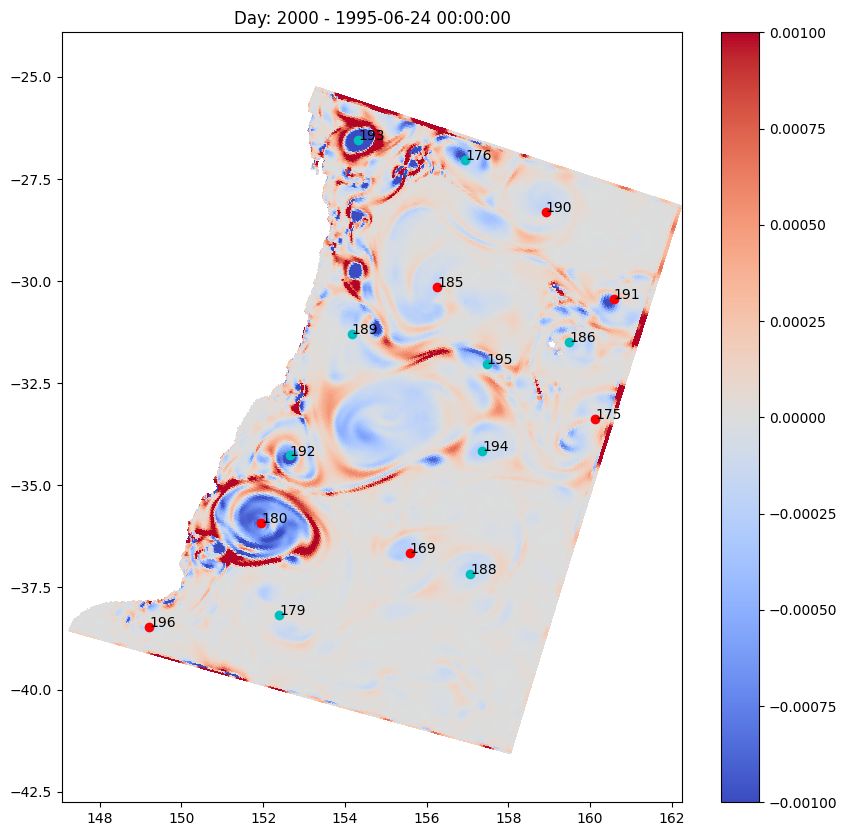

In [3]:
def local_data_plotter(df_eddies, day, X, Y, lon_rho, lat_rho):
    df = df_eddies[df_eddies['Day']==day]

    fname = df.iloc[0]['fname']
    dataset = nc.Dataset(fname)

    u_raw = np.transpose(dataset['u_eastward'][:].data, axes=(3, 2, 1, 0))
    v_raw = np.transpose(dataset['v_northward'][:].data, axes=(3, 2, 1, 0))
    ocean_time = dataset.variables['ocean_time'][:].data / 86400
    angle = dataset.variables['angle'][:].data[0,0]

    t = np.where(ocean_time==day)[0][0]

    u_east = u_raw[:, :, -1, t].squeeze()
    v_north = v_raw[:, :, -1, t].squeeze()

    u_east = np.where(u_east > 1e30, np.nan, u_east).astype(float)
    v_north = np.where(v_north > 1e30, np.nan, v_north).astype(float)
    
    u = v_north * np.sin(angle) + u_east * np.cos(angle)
    v = v_north * np.cos(angle) - u_east * np.sin(angle)

    dx = np.gradient(X, axis=0)
    dy = np.gradient(Y, axis=1)
    
    du_dx = np.gradient(u, axis=0) / dx
    du_dy = np.gradient(u, axis=1) / dy
    dv_dx = np.gradient(v, axis=0) / dx
    dv_dy = np.gradient(v, axis=1) / dy
    
    s_n = du_dx - dv_dy
    s_s = dv_dx + du_dy
    omega = dv_dx - du_dy
    
    W = s_n**2 + s_s**2 - omega**2

    plt.figure(figsize=(10,10))

    plt.pcolor(lon_rho, lat_rho, W, cmap='coolwarm', vmin=-1E-3, vmax=1E-3)
    plt.colorbar()
    plt.axis('equal')

    plt.title(f"Day: {day} - {datetime(1990, 1, 1) + timedelta(days=day)}")


    for (x0, y0, cyc, ID, q11, q12, q22) in zip(df['Lon'], df['Lat'], df['Cyc'], df['ID'], df['q11'], df['q12'], df['q22']):
        clr = 'r' if cyc == 'AE' else 'c'
        plt.scatter(x0, y0, color=clr)
        plt.text(x0, y0, ID)

local_data_plotter(df_eddies, 2000, X_grid, Y_grid, lon_rho, lat_rho)


In [37]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import netCDF4 as nc
import numpy as np
from datetime import datetime, timedelta

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 80
plt.rcParams["animation.embed_limit"] = 40
plt.ioff()

eddy = 926

fig, ax = plt.subplots(figsize=(10, 10))
days = df_eddies[df_eddies['ID']==eddy]['Day'].tolist()

# days = range(df_eddies['Day'].min(), df_eddies['Day'].min() + 365)

def animate(i):
    ax.clear()
    day = days[i]
    df = df_eddies[df_eddies['ID']==eddy]
    
    fname = df[df['Day']==day].iloc[0]['fname']
    dataset = nc.Dataset(fname)

    u_raw = np.transpose(dataset['u_eastward'][:].data, axes=(3, 2, 1, 0))
    v_raw = np.transpose(dataset['v_northward'][:].data, axes=(3, 2, 1, 0))
    ocean_time = dataset.variables['ocean_time'][:].data / 86400
    angle = dataset.variables['angle'][:].data[0, 0]

    t = np.where(ocean_time == day)[0][0]
    u_east = u_raw[:, :, -1, t].squeeze()
    v_north = v_raw[:, :, -1, t].squeeze()

    u_east = np.where(u_east > 1e30, np.nan, u_east).astype(float)
    v_north = np.where(v_north > 1e30, np.nan, v_north).astype(float)
    
    u = v_north * np.sin(angle) + u_east * np.cos(angle)
    v = v_north * np.cos(angle) - u_east * np.sin(angle)

    dx = np.gradient(X_grid, axis=0)
    dy = np.gradient(Y_grid, axis=1)
    
    du_dx = np.gradient(u, axis=0) / dx
    du_dy = np.gradient(u, axis=1) / dy
    dv_dx = np.gradient(v, axis=0) / dx
    dv_dy = np.gradient(v, axis=1) / dy

    s_n = du_dx - dv_dy
    s_s = dv_dx + du_dy
    omega = dv_dx - du_dy

    W = s_n**2 + s_s**2 - omega**2

    pcm = ax.pcolor(lon_rho, lat_rho, W, cmap='coolwarm', vmin=-1e-3, vmax=1e-3)
    ax.set_title(f"Day: {day}") # - {datetime(1990, 1, 1) + timedelta(days=day)}")
    ax.axis('equal')

    df_day = df[df['Day']==day]

    x0, y0, cyc, ID = df_day.iloc[0]['Lon'], df_day.iloc[0]['Lat'], df_day.iloc[0]['Cyc'], df_day.iloc[0]['ID']

    clr = 'r' if cyc == 'AE' else 'c'
    ax.scatter(x0, y0, color=clr)
    ax.text(x0, y0, ID, fontsize=8)

    return pcm,

ani = animation.FuncAnimation(fig, animate, frames=len(days), interval=500)
HTML(ani.to_jshtml())
